In [430]:
# Import the necessary packages
import numpy as np
import matplotlib.pyplot as plt
import scipy as sp
from scipy.integrate import odeint
from types import *
import matplotlib.animation as animation
from matplotlib import rc
import pandas as pd
import matplotlib.pyplot as plt
import os
import pandas as pd
import numpy as np
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt


In [431]:
pathName = "VitalityData/"

# List all files in the directory
all_files = os.listdir(pathName)

# Filter out non-CSV files
csv_files = [f for f in all_files if f.endswith('.csv')]

# remove files for drug 1
csv_files = [f for f in csv_files if not f.split('_')[0] == ('Drug1')]
csv_files = [f for f in csv_files if not f.split('_')[0] == ('Drug3')]
csv_files = [f for f in csv_files if not f.split('_')[0] == ('Drug5')]
csv_files = [f for f in csv_files if not f.split('_')[0] == ('Drug8')]
csv_files = [f for f in csv_files if not f.split('_')[0] == ('Drug9')]

In [432]:
# Define the exponential decay function
def exponential_decay(d, N0, k, t):
    return N0 * np.exp(-k * d *t -t/100)
t= np.arange(1, 17, 1)
k = [0.024, 0.024, 0.024, 0.01, 0.024]

#k0 drug2
#k1 drug4
#k2 drug6
#k3 drug7
#k4 drug10, no drug

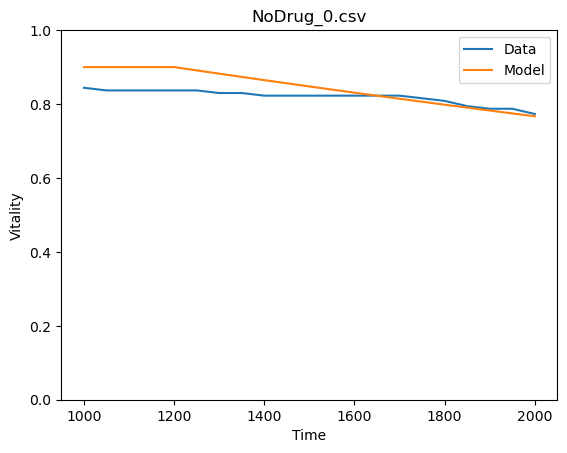

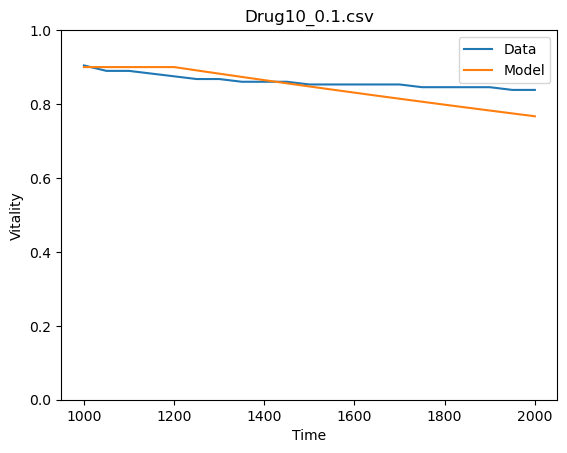

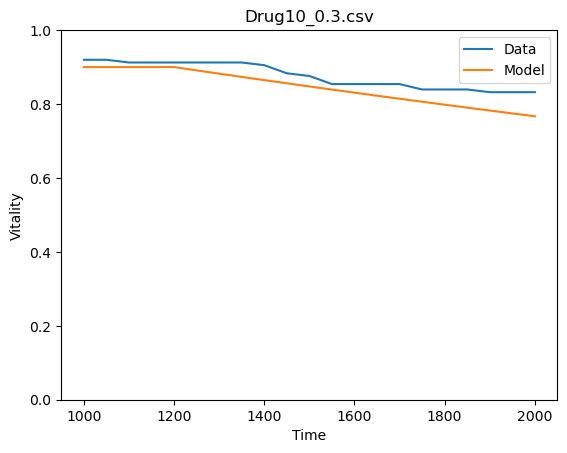

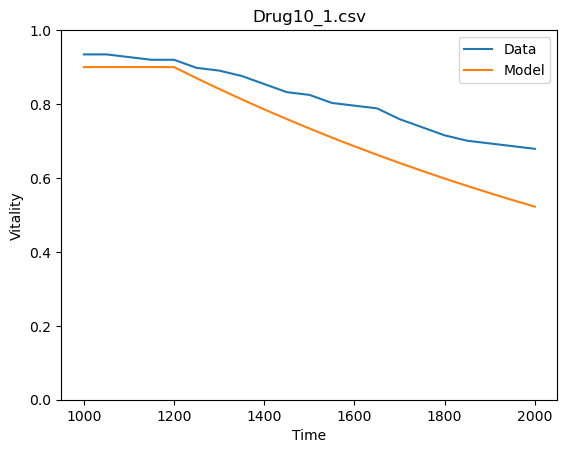

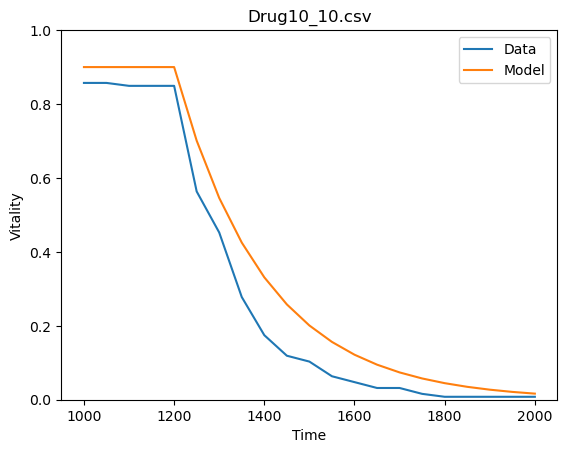

...

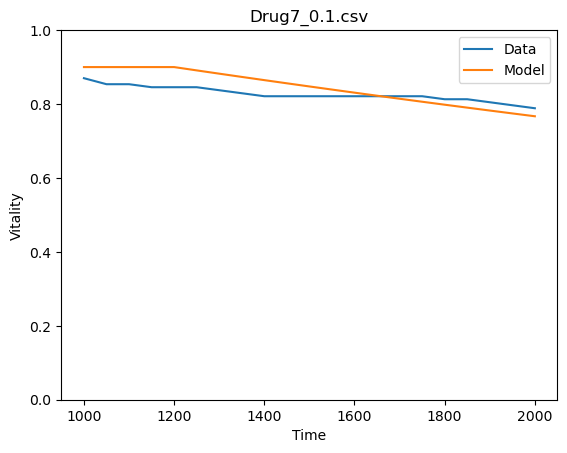

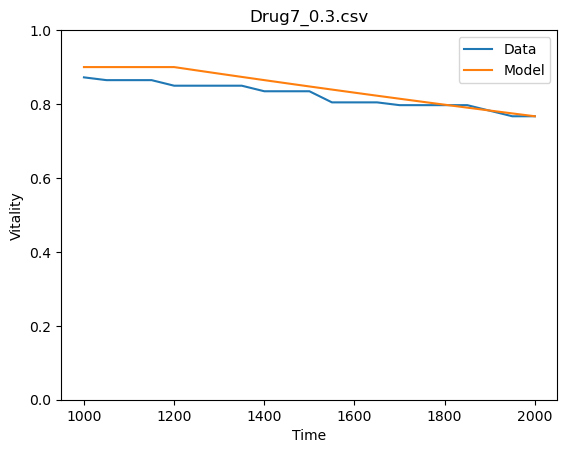

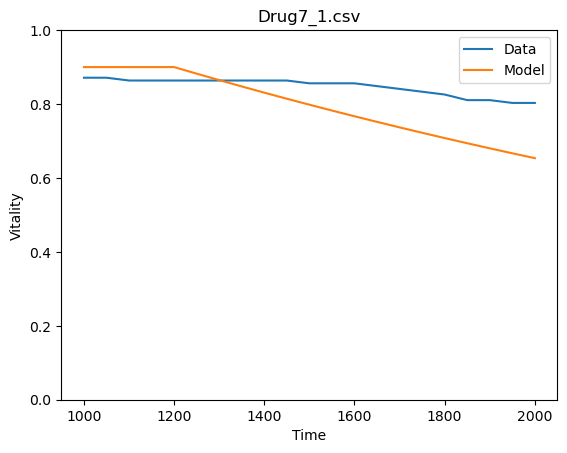

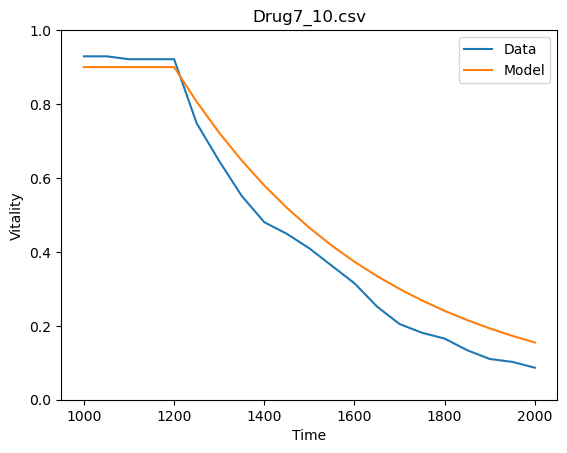

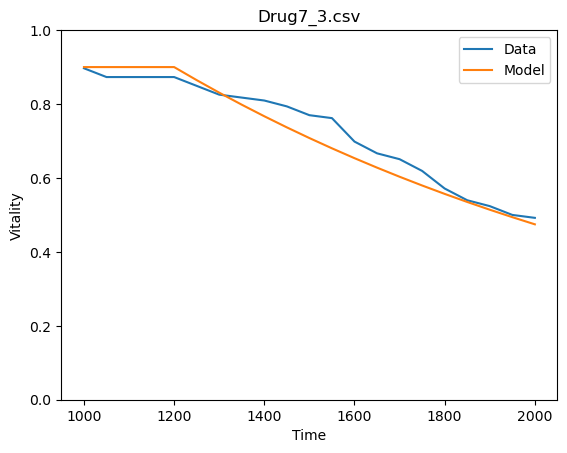

In [433]:
# read all CSV files and make a plot of vitality vs time
for i in range(len(csv_files)):
    file = csv_files[i-1]
    #take name of the file
    df = pd.read_csv(pathName + file)
    plt.plot(df['Time'], df['Vitality'])
    plt.xlabel('Time')
    plt.ylabel('Vitality')
    plt.title(file)
    #make axis from 0 to 1
    plt.ylim(0, 1)
    
    # take drug concentration from the file name
    drug_concentration = file.split('_')[1]
    # remove .csv
    drug_concentration = drug_concentration.split('.')[0]
    # convert to float
    drug_concentration = float(drug_concentration)

    data = [0.9,0.9,0.9,0.9, 0.9]

    if file.split('_')[0] == ('Drug2'):
        kr = k[0]
    elif file.split('_')[0] == ('Drug4'):
        kr = k[1]
    elif file.split('_')[0] == ('Drug6'):
        kr = k[2]
    elif file.split('_')[0] == ('Drug7'):
        kr = k[3]
    else:
        kr = k[4]
    
    # Fit the model to the data
    temp = exponential_decay(drug_concentration, 0.9, kr, t)
    data+=temp.tolist()
    plt.plot(df['Time'], data)
    # add legend
    plt.legend(['Data', 'Model'])
    plt.show()

    data_frame = pd.DataFrame(data, columns = ['Vitality'])
    data_frame.to_csv('sim_vitality/Model_vitality' + file, index = False)
    


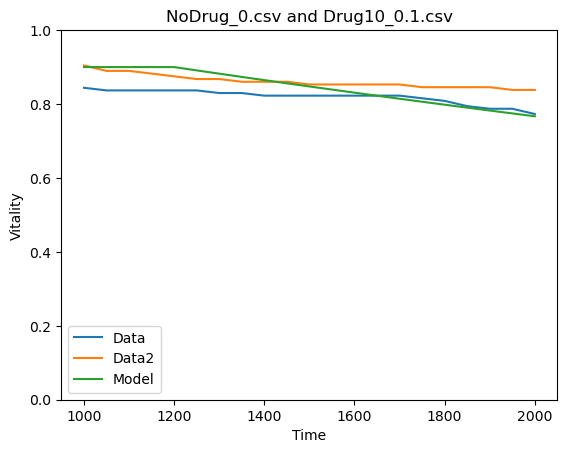

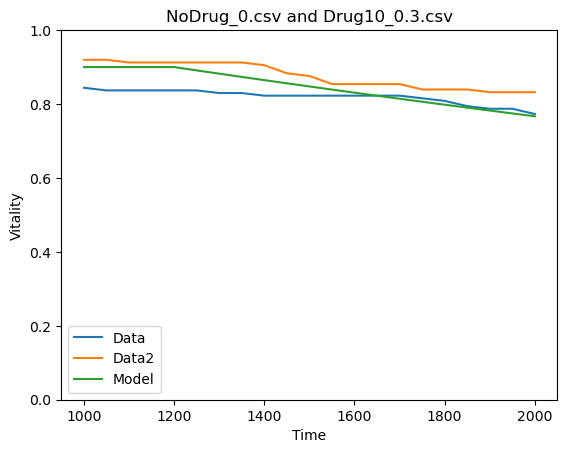

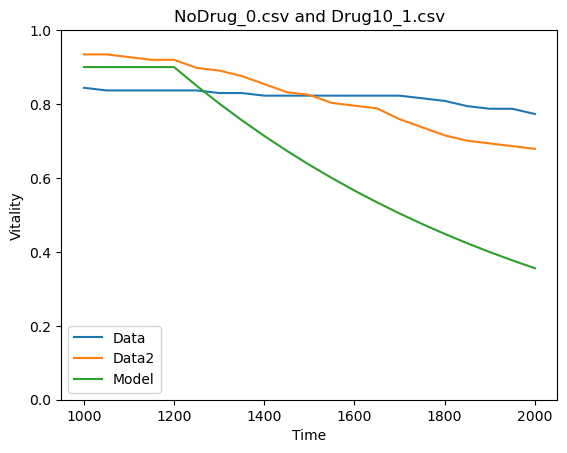

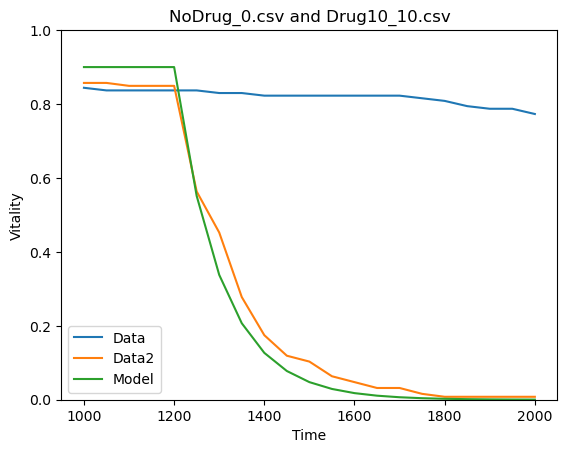

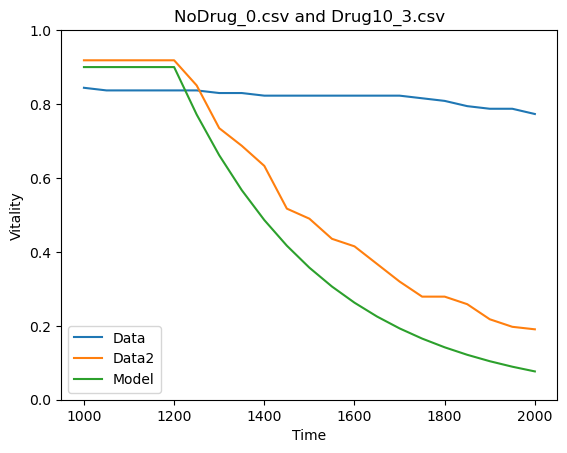

...

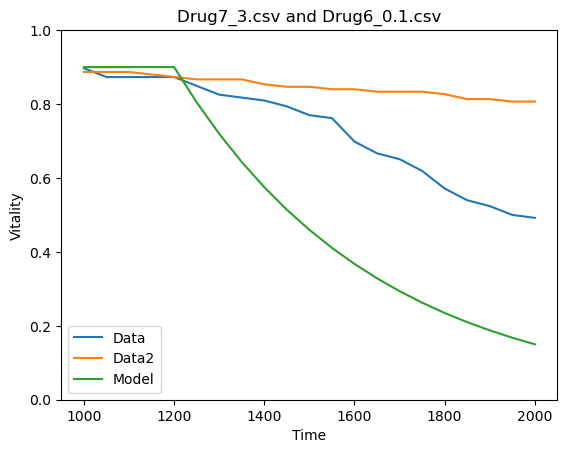

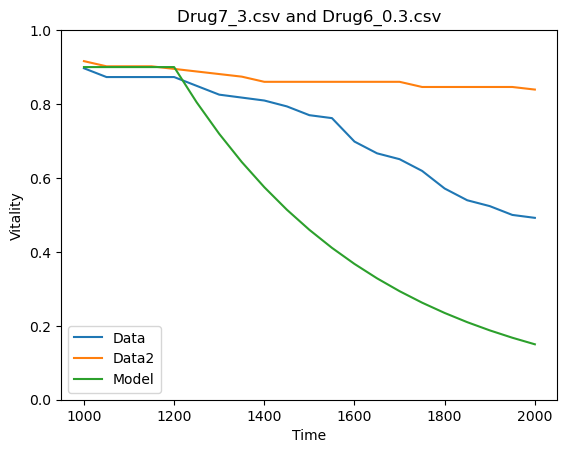

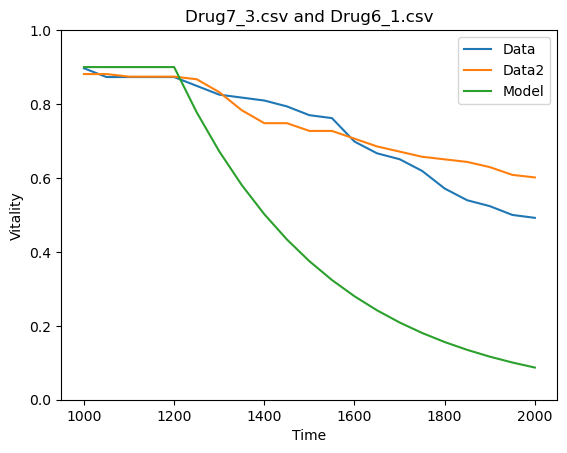

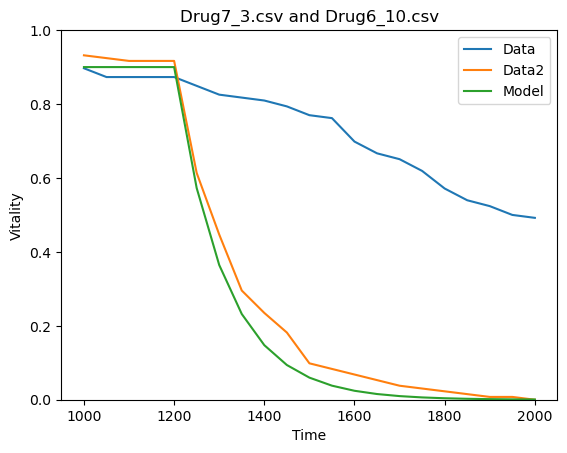

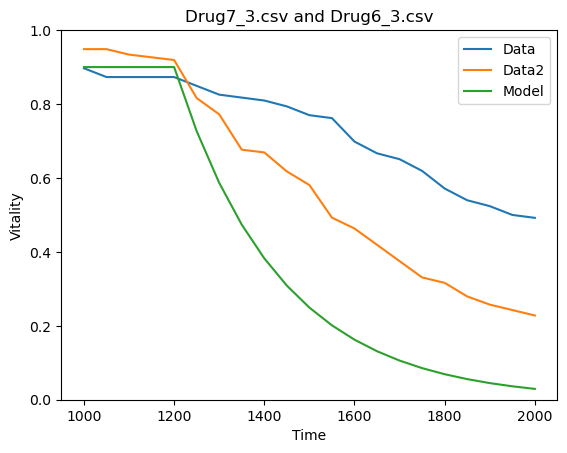

In [434]:
# do for loop to combine drug 1 and drug 2
for i in range(len(csv_files)):
    file = csv_files[i-1]

    for j in range(len(csv_files)):
        file2 = csv_files[j-1]
        #take name of the file
        df = pd.read_csv(pathName + file)

        if file != file2 and file.split('_')[0] != file2.split('_')[0]:
            df2 = pd.read_csv(pathName + file2)
            plt.plot(df['Time'], df['Vitality'])
            plt.plot(df2['Time'], df2['Vitality'])
            plt.xlabel('Time')
            plt.ylabel('Vitality')
            plt.title(file + ' and ' + file2)
            #make axis from 0 to 1
            plt.ylim(0, 1)

            # take drug concentration from the file name
            drug_concentration = file.split('_')[1]
            # remove .csv
            drug_concentration = drug_concentration.split('.')[0]
            # convert to float
            drug_concentration = float(drug_concentration)

            drug_concentration2 = file2.split('_')[1]
            # remove .csv
            drug_concentration2 = drug_concentration2.split('.')[0]
            # convert to float
            drug_concentration2 = float(drug_concentration2)

            data = [0.9,0.9,0.9,0.9,0.9]

            if file.split('_')[0] == ('Drug2'):
                kr = k[0]
            elif file.split('_')[0] == ('Drug4'):
                kr = k[1]
            elif file.split('_')[0] == ('Drug6'):
                kr = k[2]
            elif file.split('_')[0] == ('Drug7'):
                kr = k[3]
            else:
                kr = k[4]

            if file2.split('_')[0] == ('Drug2'):
                kr2 = k[0]
            elif file2.split('_')[0] == ('Drug4'):
                kr2 = k[1]
            elif file2.split('_')[0] == ('Drug6'):
                kr2 = k[2]
            elif file2.split('_')[0] == ('Drug7'):
                kr2 = k[3]
            else:
                kr2 = k[4]

            # Fit the model to the data
            temp = exponential_decay(drug_concentration+drug_concentration2, 0.9, kr+kr2, t)
            data+=temp.tolist()
            
            plt.plot(df['Time'], data)
            # add legend
            plt.legend(['Data', 'Data2', 'Model'])
            plt.show()

    
 

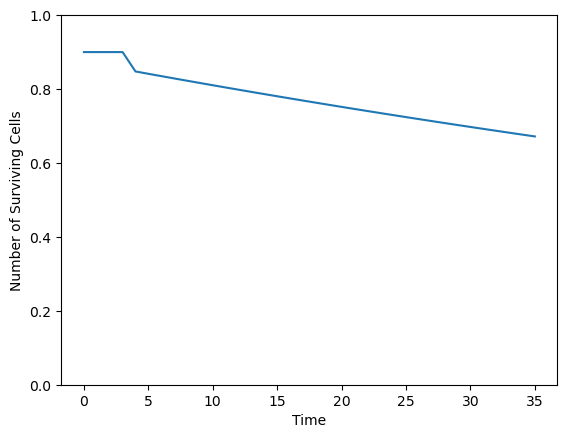

In [435]:

# Experimental data
d = np.array([100, 300, 1000, 3000, 10000])  # drug concentration
N = np.array([90, 90, 90, 90, 90])  # surviving cells

# define the time from 1000 to 2000 with step 50

data = [0.9,0.9,0.9,0.9]

t= np.arange(4, 20, 0.5)
# Define the exponential decay function
def exponential_decay(d, N0, k, t):
    return N0 * np.exp(-k * d *t)

# Fit the model to the data
temp = exponential_decay(3, 0.9, 0.005, t)
data+=temp.tolist()



# Plot the data and the fitted curve
plt.plot(data)
plt.ylabel('Number of Surviving Cells')
plt.xlabel('Time')
#make y axis from 0 to 1
plt.ylim(0, 1)
plt.show()

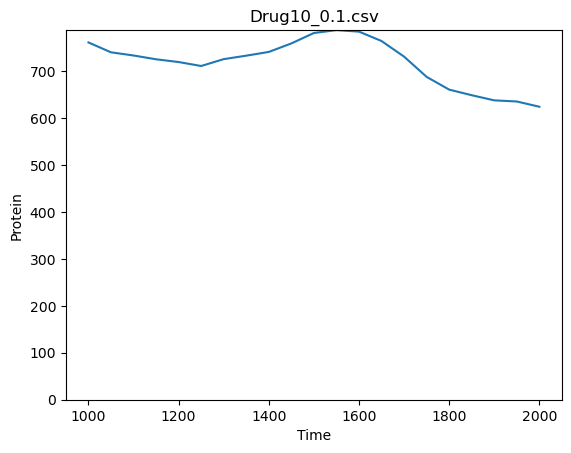

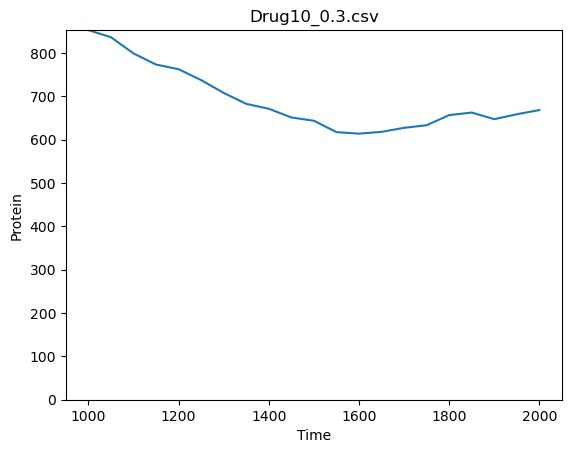

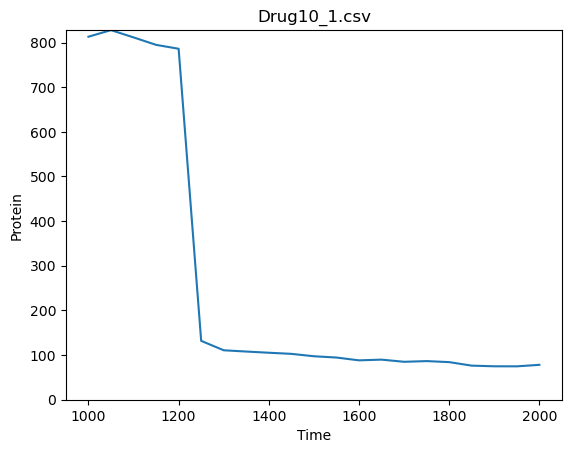

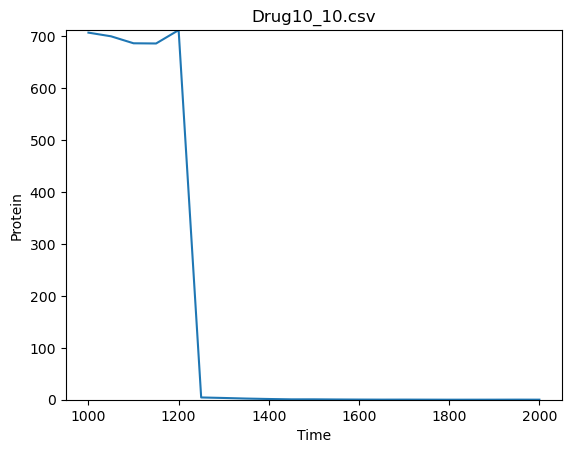

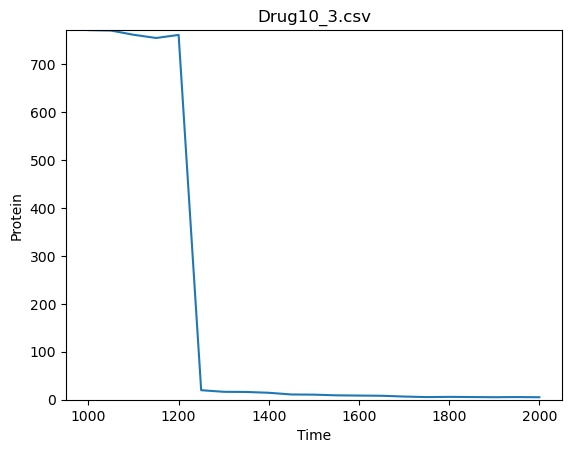

...

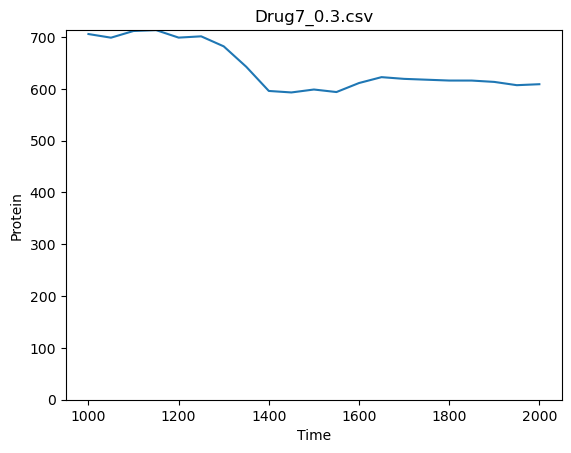

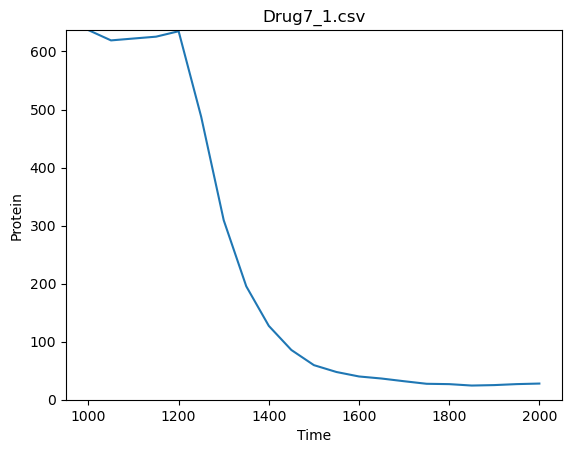

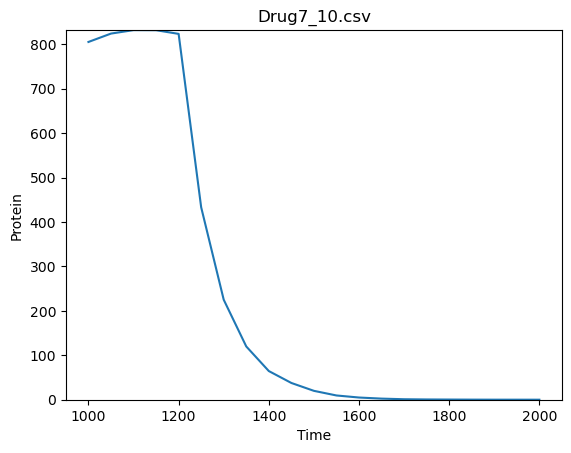

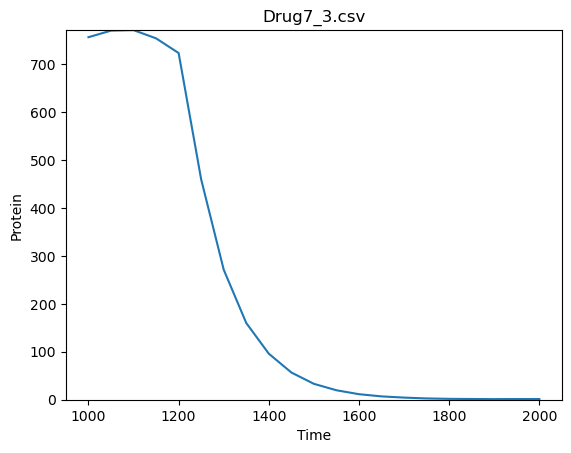

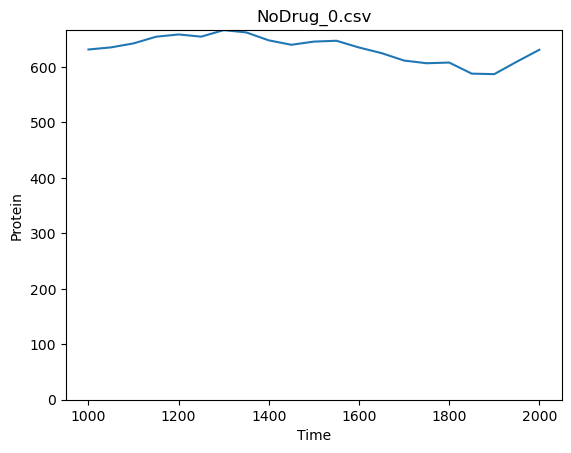

In [436]:
# read all CSV files and make a plot of vitality vs time
for file in csv_files:
    #take name of the file
    df = pd.read_csv(pathName + file)
    plt.plot(df['Time'], df['Protein'])
    plt.xlabel('Time')
    plt.ylabel('Protein')
    plt.title(file)
    #make axis from 0 to max protein
    plt.ylim(0, max(df['Protein']))
    
    plt.show()